In [1]:

import os
import geopandas as gpd
import osmnx as ox
from geopandas import GeoDataFrame

project_crs = 'epsg:3857'

from shapely.geometry import  Point, LineString, MultiPolygon, MultiPoint

import warnings

warnings.filterwarnings(action='ignore')

pjr_loc = os.path.dirname(os.path.dirname(os.getcwd()))
import ast # to convert str with list to list of string
from Code.notebooks.general_functions import Preprocessing
import pandas as pd

In [3]:
## Choose locations and create folders if necessary
preprocessing = Preprocessing('Turin')
data_folder = preprocessing.create_folder(True)


data folder:C:\Users\Achituv\My_Drive\current_projects\SOD/places/Turin_test


In [4]:
data_simplification = f'{data_folder}/data_simplification'
before_df= gpd.read_file(f'{data_folder}/before_df.shp')
after_df = gpd.read_file(f'{data_folder}/network_new.shp').drop(columns='index')

In [5]:
# step 1-4 as one def
def street_its_connections(network,is_simplified=False):
    """
    Perform a spatial join to identify all streets connected to each street in the dataset.
    :param is_simplified:Decide whether to store the status of 'is_simplified'.
    :param network:
    :return:
    """
    # vars
    str_name = 'name_left'
    con_str_name = 'name_right'
    # 1.	Copy network
    df_analysis = network.copy()
    # 2.	Internal intersection
    s_join_analysis = gpd.sjoin(df_analysis,network)
    # 3.	Delete those with the same name

    s_join_analysis2 = s_join_analysis[s_join_analysis[str_name]!=s_join_analysis[con_str_name]]
    # 4.	For each group: name: list
    group_name = s_join_analysis2.groupby(str_name)
    dic_data={}
    def connected_streets(str_lines):
        """
        Populate the dictionary with the name of the current street and all its connected streets.
        :param str_lines:
        :return:
        """
        if is_simplified: # after SOD process we also want to know if all/part of the street was simplified.
            dic_data[str_lines[str_name].iloc[0]] =(list(str_lines[con_str_name].unique()),True if (str_lines['is_simplif_left'] == 1).any() else False)
        else:
            dic_data[str_lines[str_name].iloc[0]] =(list(str_lines[con_str_name].unique()),False)
    group_name.apply(connected_streets)
    return dic_data

In [6]:
# Create dictionary of street: connected streets before and after
dic_before = street_its_connections(before_df)
print('dic_before')
dic_after = street_its_connections(after_df,is_simplified=True)
print('dic_after')

dic_before
dic_after


In [17]:
# 5. Compare between the two dictionaries
df1 = pd.DataFrame(index= dic_after.keys(), data=dic_after.values(),columns=['ConnectedStreets','is_simplified']).reset_index(names='StreetName')
df2 = pd.DataFrame(index= dic_before.keys(), data=dic_before.values(),columns=['ConnectedStreets','is_simplified']).reset_index(names='StreetName')
def common_streets(row):
        return len(set(row['ConnectedStreets']) & set(df2[df2['StreetName'] == row['StreetName']]['ConnectedStreets'].iloc[0]))
def unique_streets_in_df1(row):
    return len(set(row['ConnectedStreets']) - set(df2[df2['StreetName'] == row['StreetName']]['ConnectedStreets'].iloc[0]))

def unique_streets_in_df2(row):
    return len(set(df2[df2['StreetName'] == row['StreetName']]['ConnectedStreets'].iloc[0]) - set(row['ConnectedStreets']))

df1['CommonStreetsCount'] = df1.apply(common_streets, axis=1)
df1['UniqueStreetsInAfterCount'] = df1.apply(unique_streets_in_df1, axis=1)
df1['UniqueStreetsInBeforeCount'] = df1.apply(unique_streets_in_df2, axis=1)

df1['rate_success'] =(df1['CommonStreetsCount']/df1[['CommonStreetsCount','UniqueStreetsInAfterCount','UniqueStreetsInBeforeCount']].sum(axis=1)*100).round(0)


,StreetName,ConnectedStreets,is_simplified,CommonStreetsCount,UniqueStreetsInAfterCount,UniqueStreetsInBeforeCount
0,11,"[Strada del Campagnino, Strada dei Falconieri,...",False,4,0,0
1,18,"[Strada del Mainero, Viale Rombon]",True,2,0,0
2,Argine,"[Strada Settimo, Ponte Amedeo VIII]",False,2,0,0
3,Bertola n°1642,"[Via Santa Teresa, Via Antonio Giuseppe Bertol...",False,1,2,0
4,Ciclabile Carducci - Biglieri,"[Via Nizza, Via Alassio, Via Tepice, Via Thono...",False,12,6,0
...,...,...,...,...,...,...
2202,Vicolo Grosso,"[Via Maria Ausiliatrice, Via Masserano]",False,2,0,0
2203,Vicolo Santa Maria,"[Via Giuseppe Barbaroux, Via Stampatori, Via S...",False,2,1,1
2204,Vicolo Valtorta,[Via Gaetano Donizetti],False,1,0,0
2205,strada alle sei ville,"[Via Tonco, Corso Alberto Picco, Strada alle S...",False,2,1,0


In [37]:
# Calculate rate success
df1['rate_success'] =(df1['CommonStreetsCount']/df1[['CommonStreetsCount','UniqueStreetsInAfterCount','UniqueStreetsInBeforeCount']].sum(axis=1)*100).round(0)

# Update the original data source
after_df2 = after_df.set_index('name')
after_df2['rate_success'] = df1.set_index('StreetName')['rate_success']
after_df2.to_file(f'{data_folder}/after_df.shp')
df1.to_csv(f'{data_folder}/after_df.csv')
df2.to_csv(f'{data_folder}/before_df.csv')

In [41]:
rate_success= 'rate_success'
is_simplified= 'is_simplified'
print(f'mean: {df1[rate_success].mean()}')
print(f'mean_simplified: {df1[df1[is_simplified]][rate_success].mean()}')
print(f'mean_no_simplified: {df1[~df1[is_simplified]][rate_success].mean()}')

mean: 80.99909379247848
mean_simplified: 75.30940594059406
mean_no_simplified: 82.27398779811425


In [44]:
df1[df1['StreetName']=='Piazzetta Accademia Militare']

,StreetName,ConnectedStreets,is_simplified,CommonStreetsCount,UniqueStreetsInAfterCount,UniqueStreetsInBeforeCount,rate_success
307,Piazzetta Accademia Militare,"[Via Giuseppe Verdi, Via Giovanni Virginio, Vi...",False,1,3,0,25.0


In [ ]:
df1[df1['StreetName']=='Piazzetta Accademia Militare']

In [109]:
# Create dictionaries - by steps
# params
is_simplified = True
# vars
str_name = 'name_left'
con_str_name = 'name_right'
# 1.	Copy network
df_analysis = before_df.copy()
# 2.	Internal intersection
s_join_analysis = gpd.sjoin(df_analysis,before_df)

# 3.	Delete those with the same name
s_join_analysis2 = s_join_analysis[s_join_analysis[str_name]!=s_join_analysis[con_str_name]]

# 4.	For each group: name: list
group_name = s_join_analysis2.groupby(str_name)
dic_data={}
def connected_streets(str_lines):
    """
    Populate the dictionary with the name of the current street and all its connected streets.
    :param str_lines:
    :return:
    """
    if is_simplified: # after SOD process we also want to know if all/part of the street was simplified.
        dic_data[str_lines[str_name].iloc[0]] =(list(str_lines[con_str_name].unique()),True if (str_lines['is_simplif_left'] == 1).any() else False)
    else:
        dic_data[str_lines[str_name].iloc[0]] =(list(str_lines[con_str_name].unique()),False)
group_name.apply(connected_streets)
dic_data

,u,v,key,osmid,oneway,name,highway,reversed,length,bearing,...,access,bridge,maxspeed,junction,service,tunnel,ref,width,angle,geometry
0,13924308,945268794,0,61293337,1,Corso Principe Oddone,tertiary,False,13.724445,9.8,...,None,None,None,None,None,None,None,None,9.8,"LINESTRING (853766.683 5633753.491, 853769.009..."
1,13924308,1625774856,0,133270821,1,Piazza Statuto,primary,False,35.155717,269.6,...,None,None,None,None,None,None,None,None,89.6,"LINESTRING (853766.683 5633753.491, 853731.528..."
2,13924308,6711150268,0,125743679,1,Corso Principe Eugenio,primary,False,19.986691,251.9,...,None,None,None,None,None,None,None,None,71.9,"LINESTRING (853785.685 5633759.686, 853766.683..."
3,13924308,2006433739,0,966240517,1,Piazza Statuto,primary,False,12.929358,9.5,...,None,None,None,None,None,None,None,None,9.5,"LINESTRING (853764.556 5633740.737, 853766.683..."
4,945268794,1625774856,0,966240516,1,Corso Principe Eugenio,residential,False,39.938887,249.8,...,None,None,None,None,None,None,None,None,69.8,"LINESTRING (853769.009 5633767.016, 853731.528..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
27724,11292974631,11292974639,0,37369047,1,Corso Vittorio Emanuele II,primary,False,11.924179,117.0,...,None,None,50,None,None,None,None,None,117.0,"LINESTRING (851373.848 5633148.697, 851384.468..."
27725,11292974631,11292974632,0,133868178,1,Corso Racconigi,tertiary,False,8.515157,12.7,...,None,None,None,None,None,None,None,None,12.7,"LINESTRING (851373.848 5633148.697, 851375.718..."
27726,11292974639,11292974636,0,37369047,1,Corso Vittorio Emanuele II,primary,False,390.860381,117.1,...,None,None,50,None,None,None,None,None,117.1,"LINESTRING (851384.468 5633143.274, 851726.441..."
27727,11292974632,11293004083,0,133868178,1,Corso Racconigi,tertiary,False,10.560503,12.9,...,None,None,None,None,None,None,None,None,12.9,"LINESTRING (851375.718 5633157.004, 851378.078..."


In [ ]:
# # 4.	For each group: name: list - Code for one group
dic_data={}
# loop on one group
str_lines = group_name.get_group('Corso Chieri')
dic_data[str_lines[str_name].iloc[0]] =list(str_lines[con_str_name].unique())
# Calculate  if it is simplified
gg = True if (str_lines['is_simplif_left'] == 1).any() else False


In [100]:
row = df1.iloc[139]
row

StreetName                              Esedra
ConnectedStreets      [Via Villa della Regina]
is_simplified                            False
CommonStreetsCount                         NaN
Name: 139, dtype: object

In [92]:
df2[df2['StreetName'] == row['StreetName']]

,StreetName,ConnectedStreets,is_simplified


# Quadratic Formula

The solutions to the quadratic equation \(ax^2 + bx + c = 0\) are given by the formula:

$$
x = \frac{{-b \pm \sqrt{{b^2 - 4ac}}}}{{2a}}
$$


In [ ]:
# Test intersection network
self.my_network = remove_false_nodes(self.my_network).reset_index(drop=True)
self.my_network.to_file(f'{data_folder}/delete_2_nodes/delete_false_intersection.shp')
# Create buffer around each element
buffer_around_lines= self.my_network['geometry'].buffer(cap_style=3, distance=1, join_style=3)


# s_join between buffer to lines
s_join_0 =gpd.sjoin(left_df=GeoDataFrame(geometry=buffer_around_lines,crs=project_crs),right_df=self.my_network)

# delete lines belong to the buffer
s_join = s_join_0[s_join_0.index!=s_join_0['index_right']]


# Find new intersections that are not at the beginning or end of the line
for_time =len(s_join)
with tqdm(total=for_time) as pbar:
s_join.apply(lambda x: self.find_intersection_points(x,pbar), axis=1)
if len(self.inter_pnt_dic)==0:
return
inter_pnt_gdf = GeoDataFrame(self.inter_pnt_dic,crs=project_crs)

# Split string line by points
segments = {'geometry':[],'org_id':[]}
# Groupby points name (which is the line they should split)
my_groups =  inter_pnt_gdf.groupby('name')
for_time = len(my_groups)
with  tqdm(total=for_time) as pbar:
for group_pnts in my_groups :
    pbar.update(1)
    points  = group_pnts[1]
    points['is_split'] = True

    # get the line to split by comparing the name
    row = self.my_network.loc[group_pnts[0]]
    current = list(row.geometry.coords)
    points_line = [Point(x) for x in current]
    points_line_gdf = GeoDataFrame(geometry=points_line,crs=project_crs)
    points_line_gdf['is_split'] = False

    # append all the points together (line points and split points)
    line_all_pnts = points_line_gdf.append(points)

    # Find the distance of each point form the begining of the line on the line.
    line_all_pnts['dis_from_the_start'] = line_all_pnts['geometry'].apply(lambda x:row.geometry.project(x))
    line_all_pnts.sort_values('dis_from_the_start',inplace=True)

    # split the line
    seg =[]
    for point in line_all_pnts.iterrows():
        prop = point[1]
        seg.append(prop['geometry'])
        if prop['is_split']:
            segments['geometry'].append(LineString(seg))
            segments['org_id'].append(row.name)
            seg = [prop['geometry']]
    # if the split point is the last one, you don't need to create new segment
    if len(seg)>1:
        segments['geometry'].append(LineString(seg))
        segments['org_id'].append(row.name)
network_split = GeoDataFrame(data=segments,crs=project_crs)
cols_no_geometry = self.my_network.columns[:-1]
network_split_final = network_split.set_index('org_id')
network_split_final[cols_no_geometry] =self.my_network[cols_no_geometry]

# remove old and redundant line from our network and update with new one
network_split =self.my_network.drop(index=network_split_final.index.unique()).append(network_split_final).drop(index= self.lines_to_delete)
network_split['length'] = network_split.length
self.my_network = network_split
self.my_network.reset_index(drop=True,inplace= True)
self.my_network.reset_index().to_file(f'{data_folder}/delete_2_nodes/intersection_network.shp')


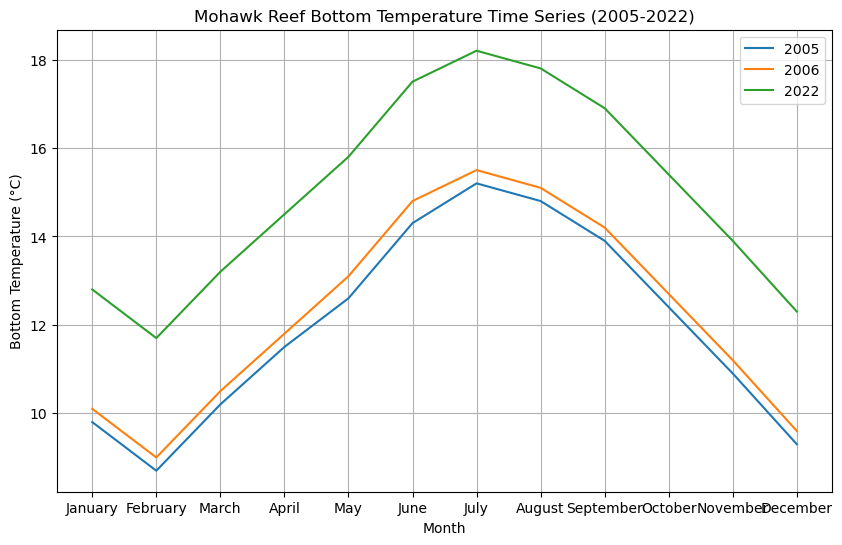

In [1]:
import matplotlib.pyplot as plt

# Define months and data (replace with your actual data)
months = ['January', 'February', 'March', 'April', 'May', 'June', 'July',
         'August', 'September', 'October', 'November', 'December']

years = range(2005, 2023)  # Adjust range as needed

temps = {
    '2005': [9.8, 8.7, 10.2, 11.5, 12.6, 14.3, 15.2, 14.8, 13.9, 12.4, 10.9, 9.3],
    '2006': [10.1, 9.0, 10.5, 11.8, 13.1, 14.8, 15.5, 15.1, 14.2, 12.7, 11.2, 9.6],
    # ... Add data for remaining years ...
    '2022': [12.8, 11.7, 13.2, 14.5, 15.8, 17.5, 18.2, 17.8, 16.9, 15.4, 13.9, 12.3]
}

# Create the figure and axes
fig, ax = plt.subplots(figsize=(10, 6))

# Loop through each year and plot its data as a line
for year, data in temps.items():
    ax.plot(months, data, label=f'{year}')

# Set labels and title
ax.set_xlabel('Month')
ax.set_ylabel('Bottom Temperature (°C)')
ax.set_title('Mohawk Reef Bottom Temperature Time Series (2005-2022)')

# Add legend and grid lines
ax.legend()
ax.grid(True)

# Show the plot
plt.show()


$$
\int_{a}^{b} f(x) dx
$$


In [46]:
# from csv to shpfile
my_gdf = gpd.read_file('places\San_Francisco__California\Streets___Active_and_Retired_20231024.csv')
# This line build a correct format of the geometry based on the data from the line column
my_gdf['geometry'] = my_gdf['line'].apply(lambda x:LineString([tuple(map(float, coords.split())) for coords in  re.split(r'\(|\)', x)[1].split(',')]))
my_gdf.crs = 'EPSG:4326'
my_gdf.to_file(r'places\San_Francisco__California\ref_shp')
my_gdf.explore()

<span style="color:red; font-size:20px"> Get 20% random sample of unique names</span>


In [149]:
# parameters
first_time = False
for place in ['Tel_Aviv','San_Francisco__California','Turin__Italy']:
    # if place!='San_Francisco__California':
    #     continue
    name ='name'

    if first_time:
        # Get Dataframe and choose only the simplified ones
        df = gpd.read_file(f'places/{place}/simp.shp')
        df[df['is_simplif']==1]['name'].unique()

        # Select 20% randomly
        unique_names = df[df['is_simplif']==1]['name'].unique()
        selected_names = pd.DataFrame(pd.Series(unique_names).sample(frac=0.2, random_state=42))
        selected_names['is_same']=''
        selected_names.set_index(0, inplace=True,)
        selected_names.index.name= 'street'
    else:
        selected_names = pd.read_csv(f'places/{place}/selected_streets.csv').set_index('Street name')[['Status 1','Status 2']]

    # Save the selected original streets in new shp files (regular and dissolve)
    df_2 = gpd.read_file(f'places/{place}/osm_data.gpkg',layer = 'edges')
    if place=='Tel_Aviv':
        df_2[name] = df_2['name:en']
        df_2.drop(columns='name:en',inplace=True)
    res = df_2[df_2[name].isin(selected_names.index)]
    res.to_file(f'places/{place}/selected_streets.shp')
    res.dissolve(by=name).sort_values(by=name).to_file(f'places/{place}/selected_diss.shp')
    # Create df to be filled in manually
    code_to_repeat = "selected_names.loc['',:]= []"

    # Loop to repeat the code
    for street in selected_names.index:
        print(f"selected_names.loc['{street}',:]= []")

selected_names.loc['Abba Ahimeir',:]= []
selected_names.loc['Avraham Shlonsky',:]= []
selected_names.loc['Bney Efraim',:]= []
selected_names.loc['Bograshov',:]= []
selected_names.loc['Brodezky',:]= []
selected_names.loc['Dvora HaNevia',:]= []
selected_names.loc['HaArad',:]= []
selected_names.loc['HaRav Alnekave',:]= []
selected_names.loc['HaTayasim',:]= []
selected_names.loc['HaYarkon',:]= []
selected_names.loc['Hanna Rovina',:]= []
selected_names.loc['Herbert Samuel',:]= []
selected_names.loc['Kehilat Kovna',:]= []
selected_names.loc['Klachkin',:]= []
selected_names.loc['Menachem Begin',:]= []
selected_names.loc['Moshe Sne',:]= []
selected_names.loc['Nachalat Itzhak',:]= []
selected_names.loc['Oppenheimer',:]= []
selected_names.loc['Sderot Ben Zion',:]= []
selected_names.loc['Shaul HaMelekh',:]= []
selected_names.loc['Weizmann',:]= []
selected_names.loc['Yehuda HaLevi',:]= []
selected_names.loc['Bosworth Street',:]= []
selected_names.loc['California Street',:]= []
selected_names.loc['

In [130]:
# It is not updated
data_dict= {0:'Success',
            1: 'A few minor flaws',
            2: 'Partially successful',
            3: "Failed",
            4:'The street of the ref network is presented partially/fully by more then one lane',
            5: 'It was not mapped into the ref network',
            6: 'The distant between the two parallel lanes are more 60 meters',
            7: 'Complex street configurations that can be interpreted as either a success or failure, depend on the need',
            8: "If a polyline representing a roundabout lacks the accompanying tag 'roundabout=True', the code will refrain from converting it into a center point representation.",
            9: "Plazas are not treated as roundabouts in the current version",
            10: 'The algorithm fails to connect nearby polylines to the roundabout due to its excessive size.',
            11: 'In certain segments, the algorithm failed to preserve the original shape.',
            12: 'Part of the street was not mapped into original OSM network'
            }
df_dict_data = pd.Series(data_dict)
df_dict_data.to_csv(f'places/status_info.csv')


In [163]:
# data Query
# Arrange the tables to align with the corresponding shapefile.
for place in ['Turin__Italy','Tel_Aviv','San_Francisco__California']:
    print(place)
    selected_streets = pd.read_csv(f'places/{place}/selected_streets.csv')
    print(selected_streets['Status 1'].value_counts())
    print(selected_streets['Status 1'].value_counts()/len(selected_streets)*100)


Turin__Italy
0    22
1    12
2     6
9     1
7     1
6     1
Name: Status 1, dtype: int64
0    51.162791
1    27.906977
2    13.953488
9     2.325581
7     2.325581
6     2.325581
Name: Status 1, dtype: float64
Tel_Aviv
0    11
1     5
2     4
3     2
Name: Status 1, dtype: int64
0    50.000000
1    22.727273
2    18.181818
3     9.090909
Name: Status 1, dtype: float64
San_Francisco__California
0    16
1     4
Name: Status 1, dtype: int64
0    80.0
1    20.0
Name: Status 1, dtype: float64


<span style="color:red; font-size:20px"> Update the new table - DONT USE</span>

In [143]:
# Arrange the tables to align with the corresponding shapefile.
for place in ['Tel_Aviv','San_Francisco__California','Turin__Italy']:
    print(place)
    selected_streets = pd.read_csv(f'places/{place}/selected_streets.csv').sort_values(by='Street name').reset_index(drop=True).to_csv(f'places/{place}/selected_streets.csv')


Tel_Aviv
San_Francisco__California
Turin__Italy


In [127]:
# Update the current key
new_list = [0, 4, None, 5, 6, 7, 2, 1, 8, 9, 3, 10, 11, 12]
my_dict = {i:key for i,key in enumerate(new_list)}
for place in ['Tel_Aviv','San_Francisco__California','Turin__Italy']:
    print(place)
    selected_streets = pd.read_csv(f'places/{place}/selected_streets.csv')
    # Split the column based on commas and expand into new columns
    selected_streets[['status1', 'status2']] = selected_streets['is_same'].str.split(',',n=1, expand=True)

    # Drop the original column if needed
    selected_streets = selected_streets.drop('is_same', axis=1)

    # Update the status with new values
    selected_streets['status1']  = selected_streets['status1'].apply(lambda x:my_dict[int(x)])
    selected_streets['status2']  = selected_streets['status2'].apply(lambda x:my_dict[int(x)] if x is not None else '' )
    selected_streets.to_csv(f'places/{place}/selected_streets.csv')
    print(selected_streets)

Tel_Aviv
          Unnamed: 0  status1 status2
0          HaTayasim        1        
1     Menachem Begin        1        
2   Avraham Shlonsky        0        
3     Herbert Samuel        0        
4           HaYarkon        2        
5    Nachalat Itzhak        2        
6             HaArad        3        
7          Bograshov        0        
8        Bney Efraim        1        
9       Hanna Rovina        0        
10       Oppenheimer        0        
11          Klachkin        0        
12         Moshe Sne        2        
13          Weizmann        1      10
14      Abba Ahimeir        0        
15     Dvora HaNevia       11        
16     Kehilat Kovna        0        
17   Sderot Ben Zion        0        
18     Yehuda HaLevi        0        
19    Shaul HaMelekh        0        
20    HaRav Alnekave        3      12
21          Brodezky        2        
San_Francisco__California
                Unnamed: 0  status1 status2
0            Geneva Avenue        4        
1  

In [2]:
import math
99/math.log(179)

19.084757468498026

In [6]:
for x in [2,4,8,16,32,64,128]:
    print(100- math.log(x)*19)


86.83020356936103
73.66040713872208
60.49061070808312
47.32081427744416
34.15101784680519
20.981221416166235
7.811424985527282


In [7]:
print(50- math.log2(95)*5)

17.150721958345258


In [3]:
import math
math.log2(4)

2.0

In [4]:
65/math.log2(100)

9.783474859079389

In [5]:
for x in [2,4,8,16,32,64,128]:
    print(75- math.log2(x)*10)

65.0
55.0
45.0
35.0
25.0
15.0
5.0
